# A Probabilistic Deep Learning Implementation in Julia
TODO: brief intro, how to use

## Bayesian Neural Network Using Blackbox Stochastic Variational Inference

In [1]:
begin
    using Flux
    using Distributions
    using Plots
    using OrderedCollections
    using Random
    using OMEinsum
    using LinearAlgebra
    using BenchmarkTools
    include("./BayesVI.jl")
    using .BayesVI
    include("./Datasets.jl")
    using .Datasets
end

┌ Info: OMEinsum loaded the CUDA module successfully
└ @ OMEinsum C:\Users\andre\.julia\packages\OMEinsum\0C2IK\src\cueinsum.jl:117


In [13]:
begin
    # Set random seed for reproducibility.
    Random.seed!(0);
    # Draw 10 models from learned posteriors for visualisation.
    number_of_models = 10;
    # Use 20 Monte Carlo samples to approximate gradient.
    mc_samples = 20;
end

20

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
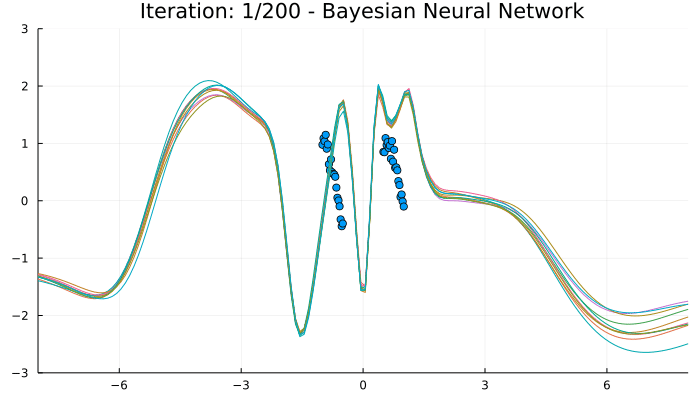

In [14]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_1()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)
end

In [15]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/dataset_1_frame_$iter.png")
end

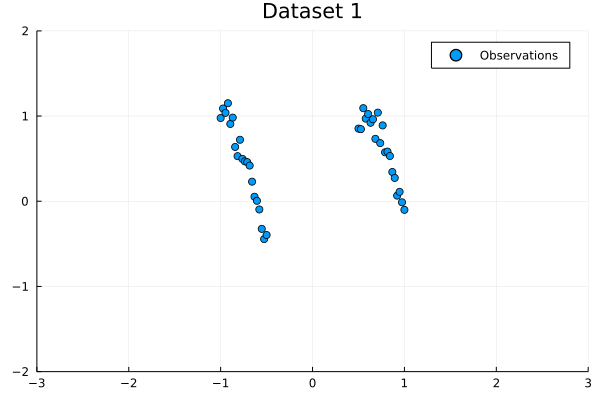

In [16]:
scatter(inputs, targets, label="Observations", title="Dataset 1", xlim=(-3, 3), ylim=(-2, 2))

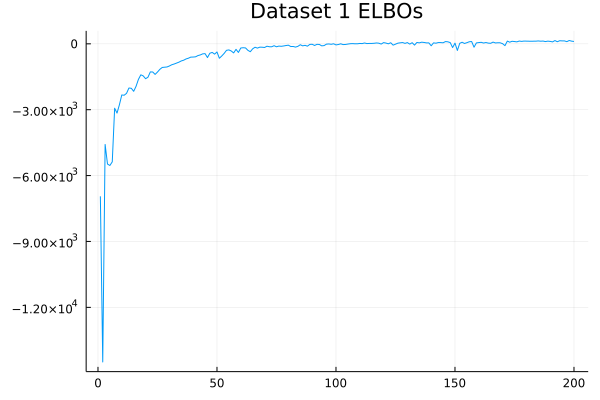

In [17]:
savefig(plot(elbos, title="Dataset 1 ELBOs", label=""), "images/dataset_1_elbos.png")
current()

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
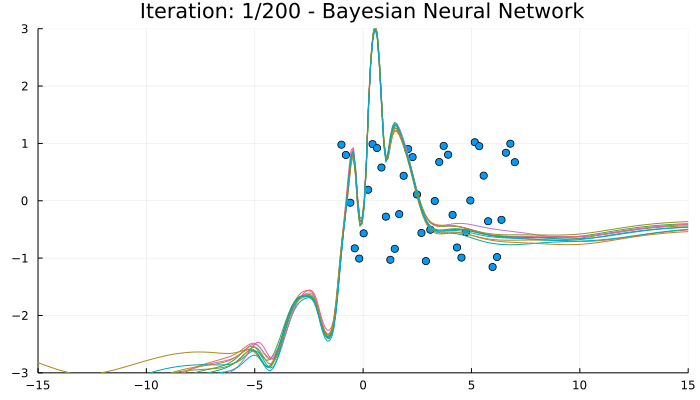

In [18]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_2()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-3, 3), (-15, 15), -15, 15, 300)
end

In [19]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 2", (-3, 3), (-15, 15), -15, 15, 150)
    fig = current()
    savefig(fig, "images/dataset_2_frame_$iter.png")
end

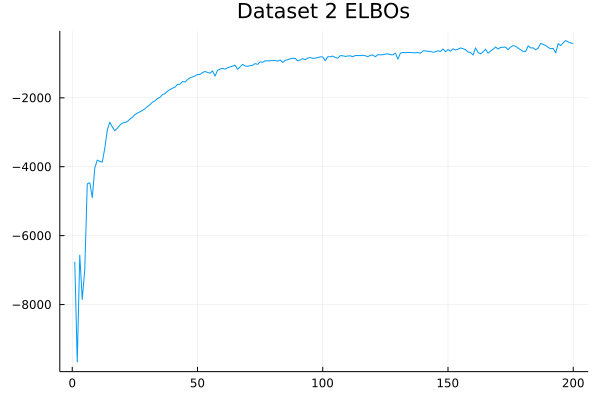

In [20]:
savefig(plot(elbos, title="Dataset 2 ELBOs",labels=""), "images/dataset_2_elbos.png")
current()

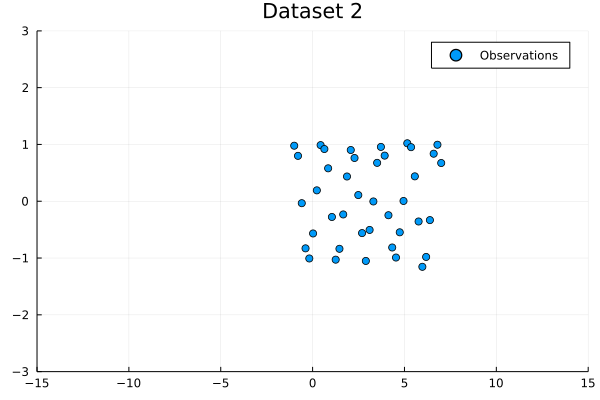

In [21]:
savefig(scatter(inputs, targets, label="Observations", title="Dataset 2", xlim=(-15, 15), ylim=(-3, 3)), "images/dataset_2.png")
current()

In [22]:
# Make some predictions
unseen_data = rand(100, 1);
no_ensemble_prediction = prediction_fn(sample_posteriors(param_hist[end]), unseen_data)
final_variational_param = param_hist[end]
ensemble_prediction(final_variational_param, unseen_data, 1)

1×100×1 Array{Float64, 3}:
[:, :, 1] =
 0.843305  0.801086  0.813245  0.826189  …  -0.366855  0.86923  0.300914

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
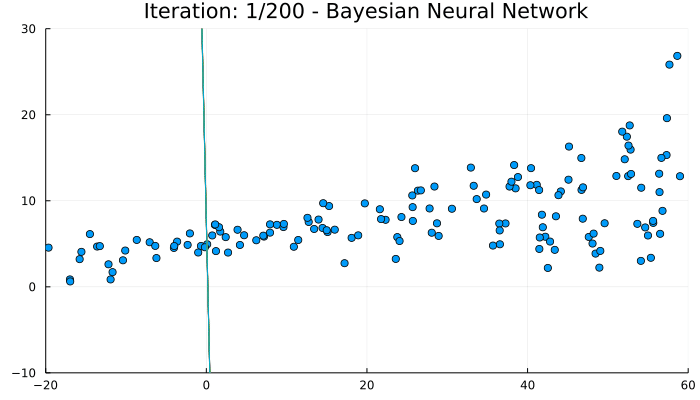

In [23]:
# Case 3 Epistemic Uncertainty
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, linear)
targets, inputs, _ = build_dataset_tfp()
targets = reshape(targets, size(targets)..., 1)
inputs = reshape(inputs, size(inputs)..., 1)
log_posterior(weights) = logprob(weights, inputs, targets)
objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-10, 30), (-20, 60), -20, 60, 300)

In [24]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Case 3 Epistemic Uncertainty", (-10, 30), (-20, 60), -20, 60, 300)
    fig = current()
    savefig(fig, "images/case_3_frame_$iter.png")
end

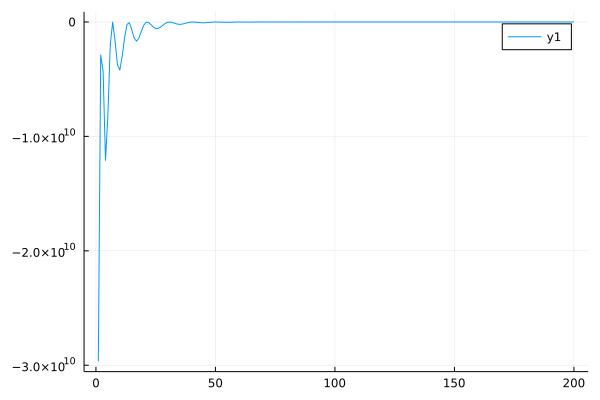

In [25]:
plot(elbos)

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
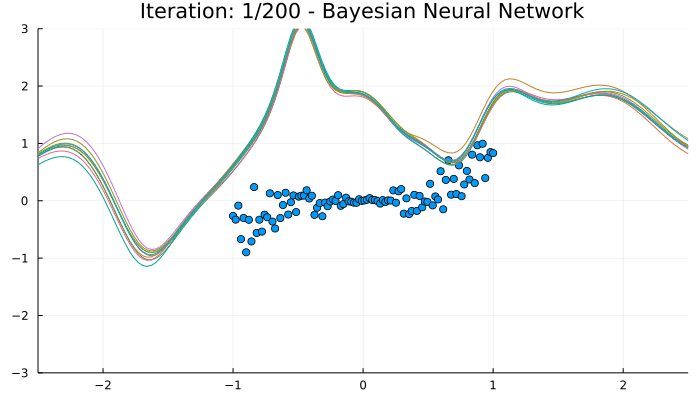

In [26]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_3()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-3, 3), (-2.5, 2.5), -2.5, 2.5, 150)
end

In [27]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 3", (-3, 3), (-2.5, 2.5), -2.5, 2.5, 150)
    fig = current()
    savefig(fig, "images/dataset_3_frame_$iter.png")
end

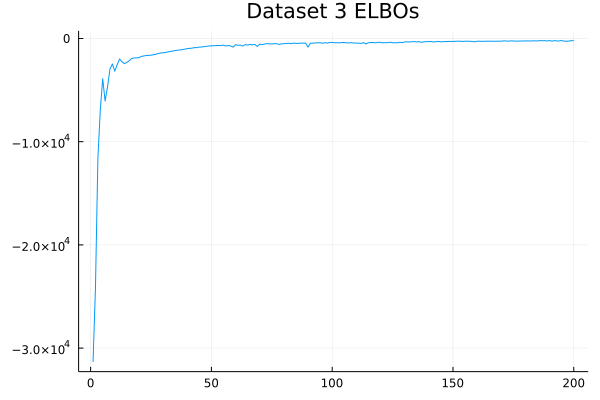

In [28]:
savefig(plot(elbos, title="Dataset 3 ELBOs",labels=""), "images/dataset_3_elbos.png")
current()

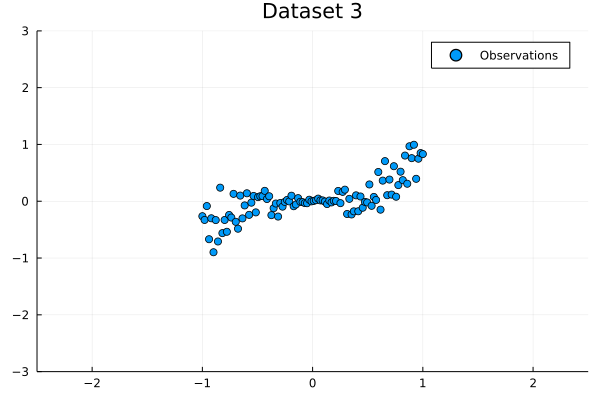

In [29]:
savefig(scatter(inputs, targets, label="Observations", title="Dataset 3", xlim=(-2.5, 2.5), ylim=(-3, 3)), "images/dataset_3.png")
current()

### Test Activation Functions (ReLU, Sigmoid, Softmax)

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
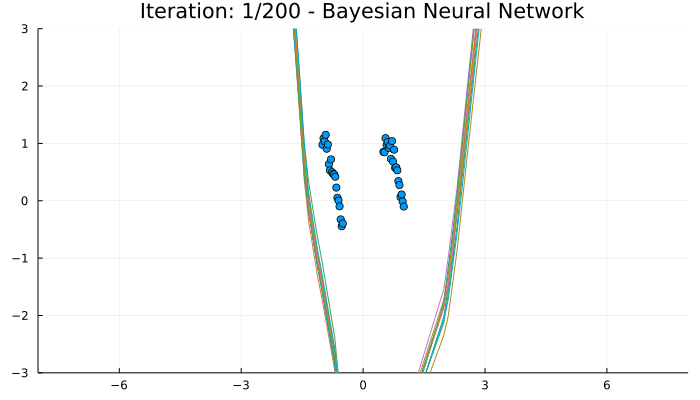

In [30]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, relu)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [31]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/relu_frame_$iter.png")
end

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
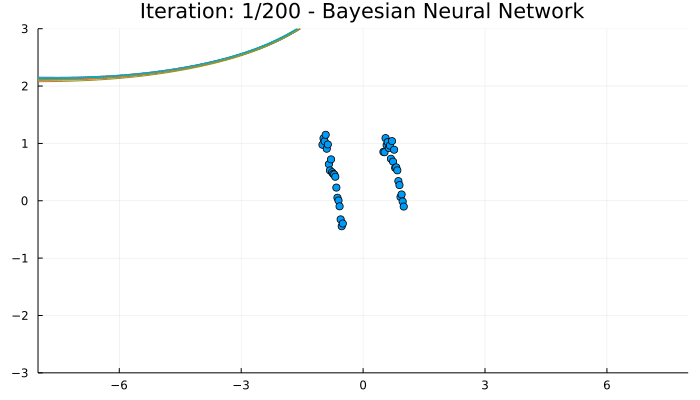

In [32]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, sigmoid)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [33]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/sigmoid_frame_$iter.png")
end

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
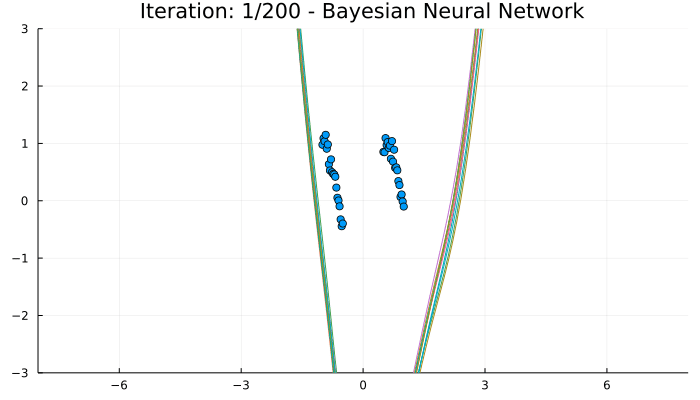

In [34]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, gelu)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective, unpack_params = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [35]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/gelu_frame_$iter.png")
end